# Image Captioning Model Implementation

---

**Authors**

Hussein Mohamed - hussain.mansour2019@gmail.com

Marwan Essam - marwanesam243@gmail.com

Mariam Hossam - m.hossam2551@gmail.com

## Introduction

Image captioning is the process of generating textual descriptions for images
automatically. It combines computer vision and natural language processing techniques to understand the content of an image and generate a coherent and relevant description.

In this notebook, we apply Convolutional Neural Network (CNN) and Recurrent Neural Network (RNN) to image captioning for Flickr8k dataset.

## Import Modules

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install datasets
!pip install keras-tuner

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 5.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 401.2/401.2 kB 6.0 MB/s eta 0:00:00
  Attempting uninstall: huggingface-hub
    Found existing installation: huggingface-hub 0.20.3
    Uninstalling huggingface-hub-0.20.3:
      Successfully uninstalled huggingface-hub-0.20.3


In [ ]:
from PIL import Image
import os
import pickle
import re
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from datasets import load_dataset
from collections import Counter
from tensorflow.keras.preprocessing.image import img_to_array, load_img
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from keras.preprocessing.sequence import pad_sequences
from keras.preprocessing.text import Tokenizer
from transformers import PreTrainedTokenizerFast
from keras import Sequential, layers
from keras.layers import *
from keras.models import Model
from tensorflow.keras.utils import to_categorical, plot_model
from tensorflow.keras.optimizers import RMSprop, Adam
from nltk.translate.bleu_score import corpus_bleu
from tensorflow.keras.utils import Sequence
from textwrap import wrap
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from keras_tuner import HyperModel
from keras_tuner import RandomSearch
from keras_tuner import Hyperband
from keras_tuner import GridSearch

In [ ]:
WORKING_DIR = '/content/drive/MyDrive/PR_3'

## Dataset Preparation

### Loading and Preprocessing Images
Loading, resizing and normalizing the images to a suitable format that can be efficiently processed by the CNN model.

1. Load dataset

For this project, we will be using the [Flickr8k](https://huggingface.co/datasets/jxie/flickr8k) dataset, which consists of 8000 images.
Each image in the dataset is associated with five different captions, providing diverse descriptions for the same image.
The dataset is divided into three subsets:
- Training Set: 6000 images
- Validation Set: 1000 images
- Test Set: 1000 images

In [ ]:
dataset = load_dataset("jxie/flickr8k")
print(dataset)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Generating train split:   0%|          | 0/6000 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/1000 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/1000 [00:00<?, ? examples/s]

DatasetDict({
    train: Dataset({
        features: ['image', 'caption_0', 'caption_1', 'caption_2', 'caption_3', 'caption_4'],
        num_rows: 6000
    })
    validation: Dataset({
        features: ['image', 'caption_0', 'caption_1', 'caption_2', 'caption_3', 'caption_4'],
        num_rows: 1000
    })
    test: Dataset({
        features: ['image', 'caption_0', 'caption_1', 'caption_2', 'caption_3', 'caption_4'],
        num_rows: 1000
    })
})


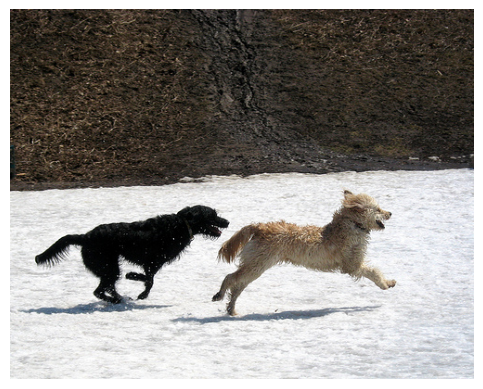

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x399 at 0x79A04D660EB0>
A black dog is running after a white dog in the snow .
Black dog chasing brown dog through snow
Two dogs chase each other across the snowy ground .
Two dogs play together in the snow .
Two dogs running through a low lying body of water .


In [ ]:
# Access specific fields in the first example
first_example = dataset['train'][0]
image = first_example['image']
plt.imshow(image)
plt.axis('off')  # Turn off axis
plt.show()
for caption in first_example:
  print(first_example[caption])

2. Preprocess images by resizing then normalizing them

We use `resnet50.preprocess_input` which adequates images to the format the resnet50 model requires. Resnet50 preprocessing uses "caffe" style in which images are centred and not normalized.

In [ ]:
# This function resize the given image to target size then normalize it
def preprocess(image):
  image = image.resize((224, 224)) # (224, 224, 3)
  image = img_to_array(image) # Convert image to pixel array
  image = np.expand_dims(image, axis = 0) # (1, 224, 224, 3)
  image = preprocess_input(image) # Preprocess image based on resnet50 values
  return image

### Features Extraction with CNN

3. Extract features from images using pre-trained ResNet model on the ImageNet dataset

- We utilize a pre-trained ResNet model on the ImageNet dataset and keep its layers frozen.
- Image features are extracted just before the last layer of classification.
- Global Average Pooling layer is selected as the final layer of the Resnet50 model for our feature extraction, so image embeddings will be a vector of size 2048.


**To avoid long running time, upload this [file](https://drive.google.com/file/d/1dDE46HK7aC-MY_3gvwXRCi1Cl8LnswNc/view?usp=sharing) to the *WORKING_DIR* then run only the last cell which loads features from the file.**

In [ ]:
base_model = ResNet50(include_top = False, weights = 'imagenet', input_shape = (224, 224, 3), pooling = 'avg')
base_model.trainable = False # Freeze model
base_model.summary()

94765736/94765736 [==============================] - 1s 0us/step
Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_3[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                      

In [ ]:
def extract_features(data):
  features = []
  for image in data:
    preprocessed_image = preprocess(image)
    feature = base_model.predict(preprocessed_image, verbose=0).reshape(2048)
    features.append(feature)
  return features

In [ ]:
features = {}
for subset in ['train', 'validation', 'test']:
  data = dataset[subset]
  images = [row['image'] for row in data]
  features[subset] = extract_features(images)

In [ ]:
print(features['train'][0].shape) # Shape of feature vector

(2048,)


In [ ]:
# store features in pickle
pickle.dump(features, open(os.path.join(WORKING_DIR, 'features.pkl'), 'wb'))

In [ ]:
# load features from pickle
with open(os.path.join(WORKING_DIR, 'features.pkl'), 'rb') as f:
    features = pickle.load(f)

### Preprocessing Captions for RNN


In [ ]:
# Load dataset into training, validation, and test sets
train_set = dataset["train"]
val_set = dataset["validation"]
test_set = dataset["test"]

**Steps for text preprocessing:**
- Convert sentences into lowercase.
- Remove all special characters and numbers present in the text.
- Remove extra spaces (multiple consecutive spaces).
- Remove single character words.
- Add a starting tag (e.g. startseq) and an ending tag (e.g. endseq) to each sentence to indicate the beginning and the ending of a sentence.

In [ ]:
def preprocess_captions(captions):
    # Convert to lowercase
    captions = [caption.lower() for caption in captions]

    # Remove special characcters and numbers in text
    captions = [caption.replace("[^A-Za-z]","") for caption in captions]

    # Remove extra spaces
    captions = [caption.replace("\s+"," ") for caption in captions]

    # Remove single character words
    captions = [' '.join(word for word in caption.split() if len(word) > 1) for caption in captions]

    # Add start and end tokens
    captions_with_start_end = ['startseq ' + caption + ' endseq' for caption in captions]

    # Fit tokenizer on text
    tokenizer = Tokenizer()
    tokenizer.fit_on_texts(captions_with_start_end)

    vocab_size = len(tokenizer.word_index) + 1

    max_len = max(len(caption.split()) for caption in captions_with_start_end)

    return captions_with_start_end, tokenizer, vocab_size, max_len

Combine images and captions into a single dataframe with 2 columns: **"image"** which stores image index in the dataset, and **"caption"** which contains one of the captions of the corresponding image after cleaning.

In [ ]:
def read_data_df(dataset):
  lst = []
  for i in range(len(dataset)):
      for caption_key in ['caption_0', 'caption_1', 'caption_2', 'caption_3', 'caption_4']:
        lst.append([i, dataset[i][caption_key]])

  df = pd.DataFrame(lst, columns=['image', 'caption'])
  return df

In [ ]:
train_data = read_data_df(train_set)
train_data.head(10)

,image,caption
0,0,A black dog is running after a white dog in th...
1,0,Black dog chasing brown dog through snow
2,0,Two dogs chase each other across the snowy gro...
3,0,Two dogs play together in the snow .
4,0,Two dogs running through a low lying body of w...
5,1,A little baby plays croquet .
6,1,A little girl plays croquet next to a truck .
7,1,The child is playing croquette by the truck .
8,1,The kid is in front of a car with a put and a ...
9,1,The little boy is playing with a croquet hamme...


Preprocessing captions of the training data and building the vocabulary of the model.

In [ ]:
cleaned_captions, tokenizer, vocab_size, max_len = preprocess_captions(train_data['caption'])
print('Vocabulary size:', vocab_size)
print('Maximum sequence length:', max_len)
train_data['caption'] = cleaned_captions
train_data.head(10)

Vocabulary size: 7368
Maximum sequence length: 34


,image,caption
0,0,startseq black dog is running after white dog ...
1,0,startseq black dog chasing brown dog through s...
2,0,startseq two dogs chase each other across the ...
3,0,startseq two dogs play together in the snow en...
4,0,startseq two dogs running through low lying bo...
5,1,startseq little baby plays croquet endseq
6,1,startseq little girl plays croquet next to tru...
7,1,startseq the child is playing croquette by the...
8,1,startseq the kid is in front of car with put a...
9,1,startseq the little boy is playing with croque...


### Preparing Output Labels

Since Image Caption model training like any other neural network training is a highly resource utillizing process we cannot load the data into the main memory all at once, and hence we need to generate the data in the required format batch wise.

The inputs will be the image embeddings and their corresonding caption text embeddings for the training process.

The output labels represent the next word in the sequence at each
sub-iteration.

<img src='https://drive.google.com/uc?id=1IOFJiycqU_hd2UEMkiRf0A_zgRKjqbL2' height=300>


In [ ]:
class CustomDataGenerator(Sequence):
  """
  Prepares output labels for a sequence prediction model.

  Returns:
      tuple: A tuple containing:
          - X1: Image features.
          - X2: Padded sequences.
          - y: Output labels.
  """
  def __init__(self, df, X_col, y_col, batch_size, tokenizer,
                vocab_size, max_length, features, shuffle=True):

      self.df = df
      self.X_col = X_col
      self.y_col = y_col
      self.batch_size = batch_size
      self.tokenizer = tokenizer
      self.vocab_size = vocab_size
      self.max_length = max_length
      self.features = features
      self.shuffle = shuffle
      self.indexes = np.arange(len(df))

  def on_epoch_end(self):
      if self.shuffle:
          np.random.shuffle(self.indexes)

  def __len__(self):
      return len(self.df) // self.batch_size

  def __getitem__(self, index):
      indexes = self.indexes[index * self.batch_size:(index + 1) * self.batch_size]
      batch = self.df.iloc[indexes]
      X1, X2, y = self.__get_data(batch)
      return (X1, X2), y

  def __get_data(self, batch):
      X1, X2, y = [], [], []

      for _, row in batch.iterrows():
          image = row[self.X_col]
          feature = self.features[image]

          caption = row[self.y_col]
          seq = self.tokenizer.texts_to_sequences([caption])[0]

          for i in range(1, len(seq)):
              in_seq, out_seq = seq[:i], seq[i]
              in_seq = pad_sequences([in_seq], maxlen=self.max_length, padding='post')[0]
              out_seq = to_categorical([out_seq], num_classes=self.vocab_size)[0]
              X1.append(feature)
              X2.append(in_seq)
              y.append(out_seq)

      return np.array(X1), np.array(X2), np.array(y)


## Model Building

According to the survey paper "[Where to put the Image in an Image Caption Generator](https://arxiv.org/abs/1703.09137)", different image captioning models are as follows:
<img src='https://drive.google.com/uc?id=1TRpQQ9ZVbHcCo-uOBiWlhqqTl7eEkK_8'>


Our model combines both pre-inject and merge structures. The pre-inject part is mainly based on the paper [**Show and Tell: A Neural Image Caption Generator**
](https://arxiv.org/pdf/1411.4555). Then we merge the image feautures with the LSTM output before passing the output through fully connected layers.

**Model Breakdown:**

1. **Input Layers:**
  - For the image features, a dense layer is used to reduce the dimensionality to `embed_size` with 'ReLU' activation.
  - For the input captions, an embedding layer is used to convert each word index into a dense representation of size `embed_size`.
2. **Concatenation:**
  - The processed image features are concatenated with the embedded captions. This concatenated vector serves as the input to the LSTM layer. The image features then act as the first word in the input sequence.
  - We apply teacher forcing during training, where the ground-truth words are fed as inputs to the LSTM at each time step during training, instead of using the model's own predictions.
3. **LSTM Layer:**
  - We use an LSTM layer with 256 units to process the concatenated input sequence.
  - The LSTM layer processes the concatenated input sequence and learns to generate the caption.
4. **Merging Layer:**
  - The output of the LSTM is added to the processed image features. This operation combines the information from the image and the caption sequence, which was proven to improve the performance of the model.
5. **Output Layers:**
  - After the LSTM layer, a dense layer is introduced with ReLU activation to further process the LSTM output.
  - Finally, a dense layer with a softmax activation function to predict the next word in the caption vocabulary.
6. **Dropout Layers:**
  - Dropout is applied to the LSTM output to prevent overfitting.
  - Another Dropout layer is applied to the output of the first dense layer for regularization.
7. **Model Compilation:**
  - We utilize cross entropy loss as the loss function while training the network.
  - We set 'Adam' as the model's optimization technique.

<img src='https://drive.google.com/uc?id=1WryBd1abTZx7vHxuAxi6r68KQcVtLERj'>

Let’s now define our ```build_model``` function, which is responsible for constructing the neural network, and returning it:


In [ ]:
class ImageCaptioningHyperModel(HyperModel):
    def __init__(self, vocab_size, max_len):
        self.vocab_size = vocab_size
        self.max_len = max_len

    def build(self, hp):
        embed_size = hp.Choice('embed_size', values=[128, 256, 512])
        lstm_units = embed_size
        dropout_rate = 0.5
        dense_units = 128
        optimizer_choice = hp.Choice('optimizer', values=['adam', 'rmsprop'])

        if optimizer_choice == 'adam':
            optimizer = Adam()
        elif optimizer_choice == 'rmsprop':
            optimizer = RMSprop()
        else:
            optimizer = SGD()

        input1 = Input(shape=(2048,))
        input2 = Input(shape=(self.max_len,))

        img_features = Dense(embed_size, activation='relu')(input1)
        img_features_reshaped = Reshape((1, embed_size), input_shape=(embed_size,))(img_features)

        sentence_features = Embedding(self.vocab_size, embed_size, mask_zero=False)(input2)
        merged = concatenate([img_features_reshaped, sentence_features], axis=1)
        sentence_features = LSTM(lstm_units)(merged)

        x = Dropout(dropout_rate)(sentence_features)
        x = add([x, img_features])
        x = Dense(dense_units, activation='relu')(x)
        x = Dropout(dropout_rate)(x)
        output = Dense(self.vocab_size, activation='softmax')(x)

        model = Model(inputs=[input1, input2], outputs=output)
        model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

        return model

In [ ]:
hypermodel = ImageCaptioningHyperModel(vocab_size=vocab_size, max_len=max_len)

In [ ]:
tuner = Hyperband(
    hypermodel,
    objective='val_loss',
    max_epochs=10, # The maximum number of epochs to train one model. This is the upper limit of the epoch that Hyperband will search
    factor=5,     # The reduction factor for the number of configurations to train in each round of Hyperband
    directory='hyperparam_tuning',
    project_name='image_captioning'
)


Reloading Tuner from hyperparam_tuning/image_captioning/tuner0.json


In [ ]:
tuner = RandomSearch(
    hypermodel,
    objective='val_loss',
    max_trials=10,
    executions_per_trial=1,
    directory='hyperparam_tuning',
    project_name='image_captioning'
)

/opt/conda/lib/python3.10/site-packages/keras/src/layers/reshaping/reshape.py:39: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [ ]:
tuner = GridSearch(
    hypermodel,
    objective='val_loss',
    max_trials=None,  # Grid Search will try all combinations
    executions_per_trial=1,
    directory='hyperparam_tuning',
    project_name='image_captioning'
)

/opt/conda/lib/python3.10/site-packages/keras/src/layers/reshaping/reshape.py:39: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


## Training

Load and preprocess validation data:

In [ ]:
val_data = read_data_df(val_set)
val_cleaned_captions, _, _, _ = preprocess_captions(val_data['caption'])
val_data['caption'] = val_cleaned_captions
val_data.head(10)

,image,caption
0,0,startseq the boy laying face down on skateboar...
1,0,startseq two girls play on skateboard in court...
2,0,startseq two people play on long skateboard en...
3,0,startseq two small children in red shirts play...
4,0,startseq two young children on skateboard goin...
5,1,startseq boy in blue top is jumping off some r...
6,1,startseq boy jumps off tan rock endseq
7,1,startseq boy jumps up in field in the woods en...
8,1,startseq young boy jumps off rock in the fores...
9,1,startseq child in blue and grey shirt jumping ...


Initialize the train and validation generators with `batch size = 64`:

In [ ]:
train_generator = CustomDataGenerator(df=train_data, X_col='image', y_col='caption', batch_size=64,
                                      tokenizer=tokenizer, vocab_size=vocab_size, max_length=max_len,
                                      features=features['train'])

validation_generator = CustomDataGenerator(df=val_data, X_col='image', y_col='caption', batch_size=64,
                                           tokenizer=tokenizer, vocab_size=vocab_size, max_length=max_len,
                                           features=features['validation'])

We define our checkpoints and early stopping mechanism to stop training when overfitting is detected:

In [ ]:
model_name = "model.keras"
checkpoint = ModelCheckpoint(model_name,
                            monitor="val_loss",
                            mode="min",
                            save_best_only = True,
                            verbose=1)

earlystopping = EarlyStopping(monitor='val_loss',min_delta = 0, patience = 5, verbose = 1, restore_best_weights=True)

learning_rate_reduction = ReduceLROnPlateau(monitor='val_loss',
                                            patience=3,
                                            verbose=1,
                                            factor=0.2,
                                            min_lr=0.00000001)

Adjust the hyperparameters to determine the optimal values for building the model. Then, use the best model for fitting the data.

In [ ]:
tuner.search(train_generator,
             validation_data=validation_generator,
             epochs=10,
             callbacks=[checkpoint, earlystopping])

best_hyperparameters = tuner.get_best_hyperparameters(num_trials=1)[0]

best_model = tuner.hypermodel.build(best_hyperparameters)

Trial 6 Complete [00h 10m 47s]
val_loss: 4.374006748199463

Best val_loss So Far: 3.7370548248291016
Total elapsed time: 01h 00m 52s


In [ ]:
print("Best Hyperparameters:")
for param in best_hyperparameters.values:
    print(f"{param}: {best_hyperparameters.get(param)}")

Best Hyperparameters:
embed_size: 256
optimizer: adam


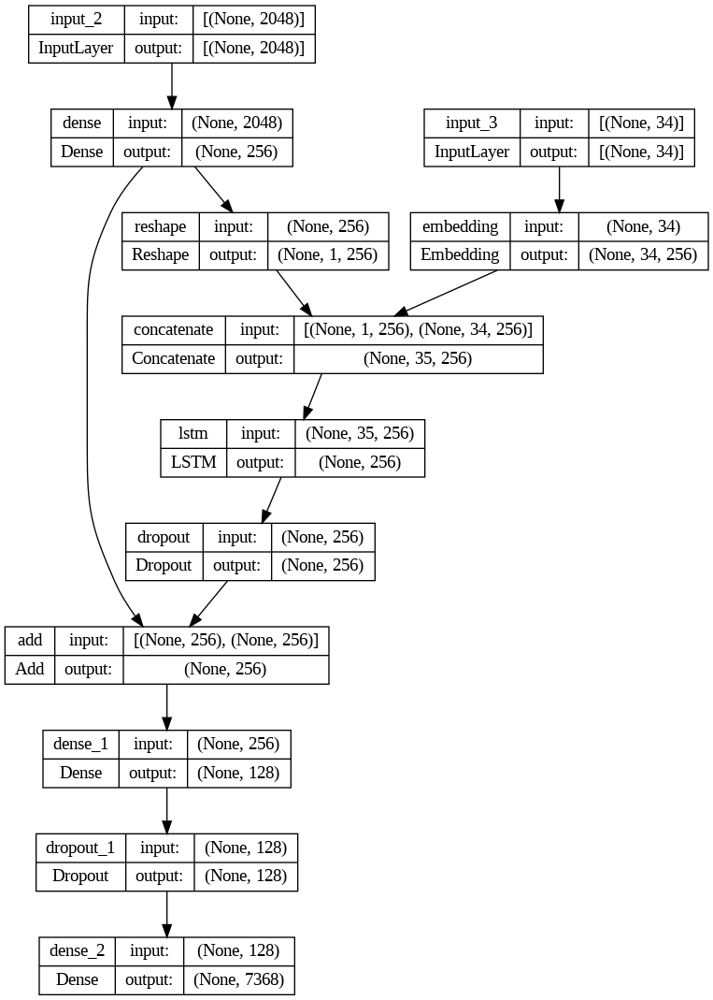

In [ ]:
plot_model(best_model, show_shapes=True)

After building the model, the model is fit using the training dataset. The model is made to run for 50 epochs and the best model is chosen among the 50 epochs by computing loss function on validation dataset. The model with the lowest loss value is chosen for generating captions.

In [ ]:
history = best_model.fit(
        train_generator,
        validation_data = validation_generator,
        callbacks=[checkpoint, earlystopping],
        epochs=50)

Epoch 1/50
468/468 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step - accuracy: 0.1292 - loss: 5.6866
Epoch 1: val_loss improved from inf to 4.22917, saving model to model.keras
468/468 ━━━━━━━━━━━━━━━━━━━━ 61s 126ms/step - accuracy: 0.1293 - loss: 5.6854 - val_accuracy: 0.2466 - val_loss: 4.2292
Epoch 2/50
468/468 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step - accuracy: 0.2429 - loss: 4.2919
Epoch 2: val_loss improved from 4.22917 to 3.90175, saving model to model.keras
468/468 ━━━━━━━━━━━━━━━━━━━━ 59s 125ms/step - accuracy: 0.2429 - loss: 4.2918 - val_accuracy: 0.2775 - val_loss: 3.9017
Epoch 3/50
468/468 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step - accuracy: 0.2667 - loss: 3.9836
Epoch 3: val_loss improved from 3.90175 to 3.75650, saving model to model.keras
468/468 ━━━━━━━━━━━━━━━━━━━━ 59s 125ms/step - accuracy: 0.2667 - loss: 3.9835 - val_accuracy: 0.2881 - val_loss: 3.7565
Epoch 4/50
468/468 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step - accuracy: 0.2833 - loss: 3.7787
Epoch 4: val_loss improved from 3.75650 to 3.66641, 

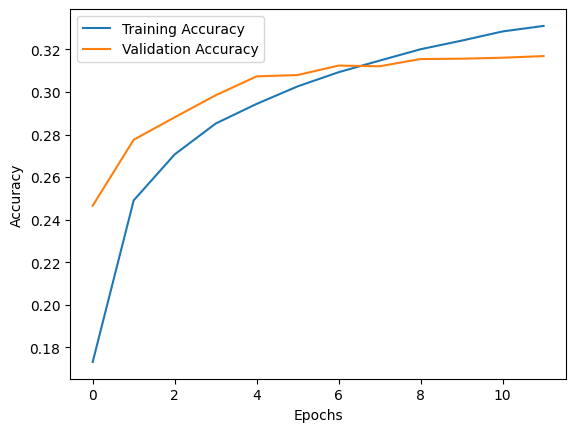

In [ ]:
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


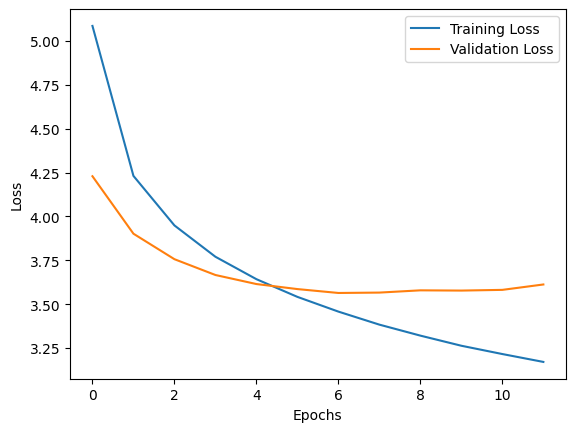

In [ ]:
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


## Inference

Here the image embeddings are passed along with the first word to the model. The predicted word is then added to the previous sequence and passed to generate the next word. The process continues till the reaching the end tag or the maximum sequence length.

<img src='https://drive.google.com/uc?id=1MdczKQotxwPeFS4HJ5FEmteTLLtWh-ly'>

In [ ]:
def idx_to_word(integer, tokenizer):
    for word, index in tokenizer.word_index.items():
        if index == integer:
            return word
    return None

In [ ]:
# generate caption for an image
def predict_caption(model, image, tokenizer, max_length):
    in_text = 'startseq'

    # iterate over the max length of sequence
    for i in range(max_length):
        # encode input sequence
        sequence = tokenizer.texts_to_sequences([in_text])[0]
        sequence = pad_sequences([sequence], max_length)

        yhat = model.predict([image, sequence], verbose=0)
        # get index with high probability
        yhat = np.argmax(yhat)
        word = idx_to_word(yhat, tokenizer)

        # stop if word not found
        if word is None:
            break

        # append word as input for generating next word
        in_text += " " + word

        # stop if we reach end tag
        if word == 'endseq':
            break

    return in_text

## Evaluation


### Quantitative Results

Report loss, accuracy and bleu score on test data:

In [ ]:
# Load model
best_model = tuner.hypermodel.build(best_hyperparameters)

# Load model weights
best_model.load_weights(os.path.join(WORKING_DIR, 'model_weights.weights.h5'))


In [ ]:
# Load and preprocess test data
test_data = read_data_df(test_set)
test_cleaned_captions, _, _, _ = preprocess_captions(test_data['caption'])
test_data['caption'] = test_cleaned_captions
test_data.head(10)

,image,caption
0,0,startseq the dogs are in the snow in front of ...
1,0,startseq the dogs play on the snow endseq
2,0,startseq two brown dogs playfully fight in the...
3,0,startseq two brown dogs wrestle in the snow en...
4,0,startseq two dogs playing in the snow endseq
5,1,startseq brown and white dog swimming towards ...
6,1,startseq dog in swimming pool swims toward som...
7,1,startseq dog swims in pool near person endseq
8,1,startseq small dog is paddling through the wat...
9,1,startseq the small brown and white dog is in t...


In [ ]:
test_generator = CustomDataGenerator(df=test_data, X_col='image', y_col='caption', batch_size=64,
                                    tokenizer=tokenizer, vocab_size=vocab_size, max_length=max_len,
                                    features=features['test'], shuffle=False)

# Evaluate the model on the test data
results = best_model.evaluate(test_generator)
print(f"Test Loss: {results[0]}")
print(f"Test Accuracy: {results[1]*100}%")

78/78 ━━━━━━━━━━━━━━━━━━━━ 9s 115ms/step - accuracy: 0.3200 - loss: 3.4906
Test Loss: 3.481898546218872
Test Accuracy: 32.18182623386383%


In [ ]:
def evaluate_model(model, data, tokenizer, max_length, features):
  actual, predicted = list(), list()

  # step over the whole set
  for idx in range(len(features)):
    feature = features[idx]
    captions = data.loc[data['image']==idx, 'caption'].tolist()

    # generate description
    yhat = predict_caption(model, np.array([feature]), tokenizer, max_length)

    references = [caption.split() for caption in captions]
    actual.append(references)
    predicted.append(yhat.split())

  # calculate BLEU score
  print('BLEU-1: %f' % corpus_bleu(actual, predicted, weights=(1.0, 0, 0, 0)))
  print('BLEU-2: %f' % corpus_bleu(actual, predicted, weights=(0.5, 0.5, 0, 0)))
  print('BLEU-3: %f' % corpus_bleu(actual, predicted, weights=(0.3, 0.3, 0.3, 0)))
  print('BLEU-4: %f' % corpus_bleu(actual, predicted, weights=(0.25, 0.25, 0.25, 0.25)))

In [ ]:
evaluate_model(best_model, test_data, tokenizer, max_len, features['test'])

BLEU-1: 0.631338
BLEU-2: 0.396658
BLEU-3: 0.286683
BLEU-4: 0.151087


### Qualitative Results

In [ ]:
def display_images_with_captions(images, captions, cols=2):
    rows = (len(images) + cols - 1) // cols
    fig, axes = plt.subplots(rows, cols, figsize=(15, 5*rows))
    axes = axes.flatten()

    for img, caption, ax in zip(images, captions, axes):
        #img = Image.open(img_path)
        ax.imshow(img)
        ax.axis('off')
        ax.set_title(caption)

    for ax in axes[len(images):]:
        fig.delaxes(ax)

    plt.tight_layout()
    plt.show()


In [ ]:
def display_images_from_dir(image_dir):
  # Get image paths
  images = [load_img(os.path.join(image_dir, img_name)) for img_name in os.listdir(image_dir)]
  captions = []

  for img in images:
    processed_image = preprocess(img)
    image_features = base_model.predict(processed_image, verbose=0)
    caption = predict_caption(model, image_features, tokenizer, max_len)
    captions.append(caption)

  display_images_with_captions(images, captions, cols=2)


Test on images from the test set:

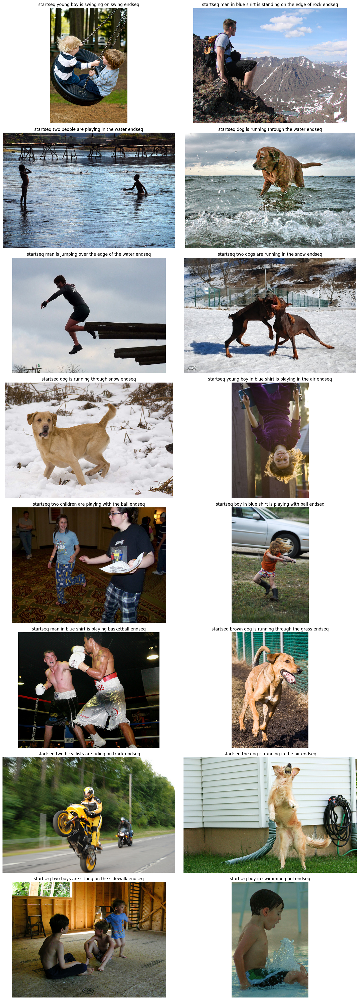

In [ ]:
samples = test_data.sample(16)
samples.reset_index(drop=True, inplace=True)

for index, record in samples.iterrows():
  id = record['image']
  image = features['test'][id]
  caption = predict_caption(model, np.array([image]), tokenizer, max_len)
  samples.loc[index, 'image'] = test_set['image'][id]
  samples.loc[index,'caption'] = caption

display_images_with_captions(samples['image'], samples['caption'], 2)

Test on images from ImageNet dataset on which the CNN model is pretrained on:

=========================== ImageNet Dataset ===========================



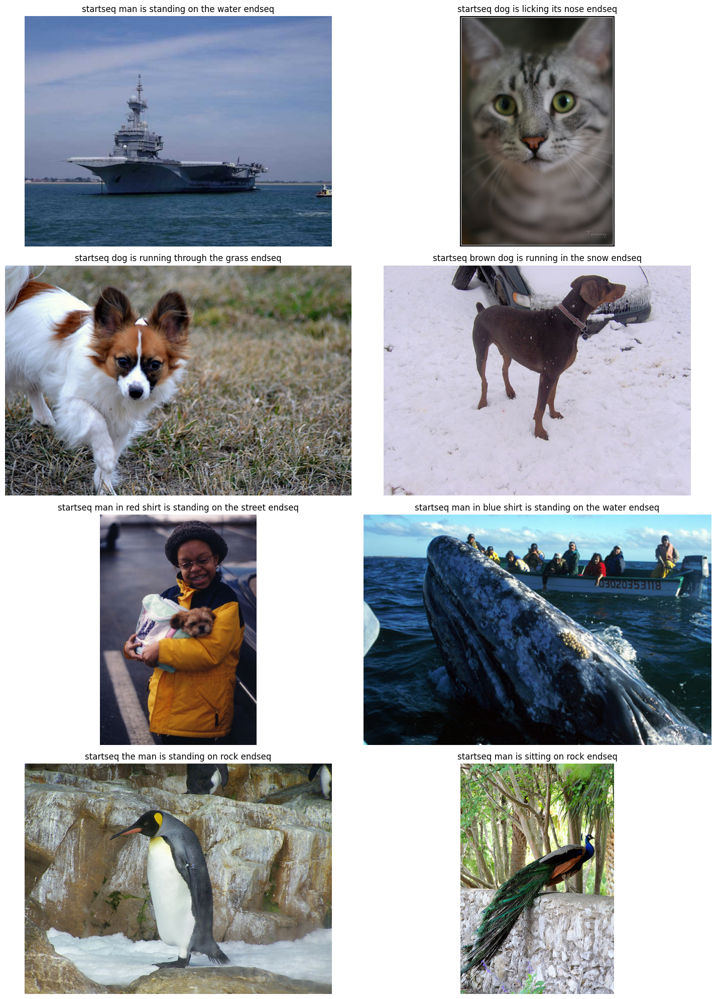

In [ ]:
print('=========================== ImageNet Dataset ===========================\n')
image_dir = os.path.join(WORKING_DIR, 'test_images/ImageNet')
display_images_from_dir(image_dir)

Test on new images from COCO dataset:

===========================COCO Dataset===========================



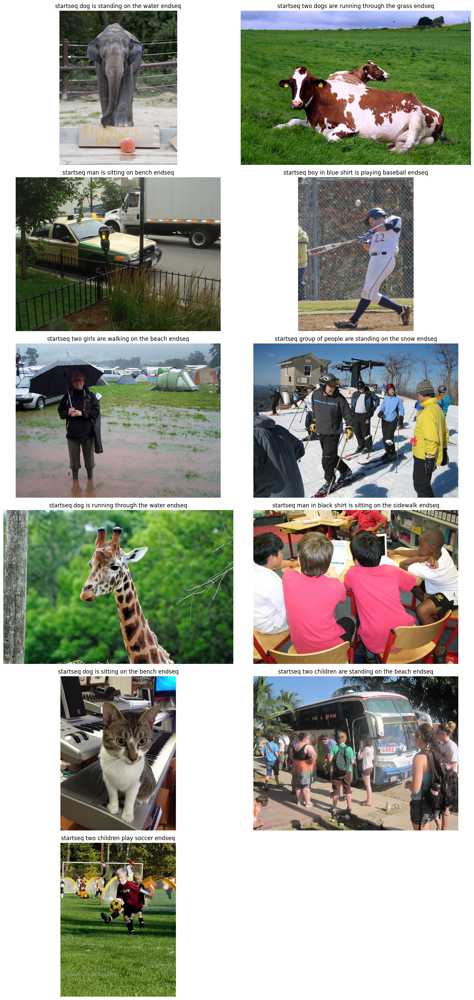

In [ ]:
print('=========================== COCO Dataset ===========================\n')
image_dir = os.path.join(WORKING_DIR, 'test_images/COCO')
display_images_from_dir(image_dir)

**Results:**
- As we can clearly see there is some redundant caption generation e.g. Dog for any animal, man for unidentified objects, overusage of 'shirt' for any other type of cloth.
- The model confuses many colors, with the overusage of red and blue colors.
- The model also fails sometimes to clearly specify the number of people in the image e.g. two while only one person exits, one or two for a group of people.
- When there are multiple objects in an image, the model sometimes fails to recognize all of them especially those farther away from the camera.
- The model correctly identifies dogs, grass, snow, water, and types of sports in most cases.
- The model performance can be further improved by training on more data and using attention mechanism so that our model can focus on relevant areas during the text generation.


## Comments

**Performance:**
- The model has clearly overfit, possibly due to less amount of data.
- We used dropout layers, regularization, learning rate scheduling, and decreasing model's complexity to overcome overftitting but none of these methods seemed to achieve any improvement.
- The model achieves high loss value (\~3.6) and low accuracy (\~31%) on validation data.
- Nevertheless, the model acheives a good bleu 1 score (\~0.63).

**Areas of Improvement:**
- We can tackle the overfitting problem in two ways:
  - Train the model on a larger dataset e.g. Flickr30k
  - Attention Models
- Increase the training time (number of epochs).
- Use beam search to generate captions for a better performance.

## Attention Mechanism

The attention mechanism is a technique used in deep learning that focuses on different parts of an input sequence when predicting the next part of the sequence. It is widely used in sequence-to-sequence models, such as machine translation and image captioning, to improve the model's performance.

### Attention Model Architecture

**Steps to Add Attention Mechanism:**

**Define the Attention Layer:** This layer will calculate the attention scores and context vectors.

**Compute Attention Weights:** Using the attention layer to compute the weights.

**Apply the Attention Weights:** Applying the attention weights to the encoder outputs to obtain a context vector.

**Concatenate the Context Vector:** Combine the context vector with the decoder input.

**Proceed with the Decoder:** Continue with the decoder as originally.

In [ ]:
class Attention(Layer):
    def __init__(self, units):
        super(Attention, self).__init__()
        self.W1 = Dense(units)
        self.W2 = Dense(units)
        self.V = Dense(1)

    def call(self, features, hidden):
        # features shape: (batch_size, max_len, embedding_dim)
        # hidden shape: (batch_size, embedding_dim)
        hidden_with_time_axis = tf.expand_dims(hidden, 1)

        # Score shape: (batch_size, max_len, 1)
        score = tf.nn.tanh(self.W1(features) + self.W2(hidden_with_time_axis))
        attention_weights = tf.nn.softmax(self.V(score), axis=1)

        # Context vector shape: (batch_size, embedding_dim)
        context_vector = attention_weights * features
        context_vector = tf.reduce_sum(context_vector, axis=1)

        return context_vector, attention_weights


In [ ]:
def build_model(embed_size, max_len, vocab_size):
    input1 = Input(shape=(2048,))
    input2 = Input(shape=(max_len,))

    # Image feature branch
    img_features = Dense(embed_size, activation='relu')(input1)
    img_features_reshaped = Reshape((1, embed_size))(img_features)

    # Sentence feature branch
    sentence_features = Embedding(vocab_size, embed_size, mask_zero=False)(input2)

    # Concatenate image and sentence features
    merged = concatenate([img_features_reshaped, sentence_features], axis=1)

    # LSTM layer
    lstm_output, state_h, state_c = LSTM(256, return_sequences=True, return_state=True)(merged)

    # Attention layer
    attention = Attention(256)
    context_vector, attention_weights = attention(lstm_output, state_h)

    # Add attention context vector to LSTM output
    x = Dropout(0.5)(context_vector)
    x = add([x, img_features])
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)
    output = Dense(vocab_size, activation='softmax')(x)

    model = Model(inputs=[input1, input2], outputs=output)
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

    return model


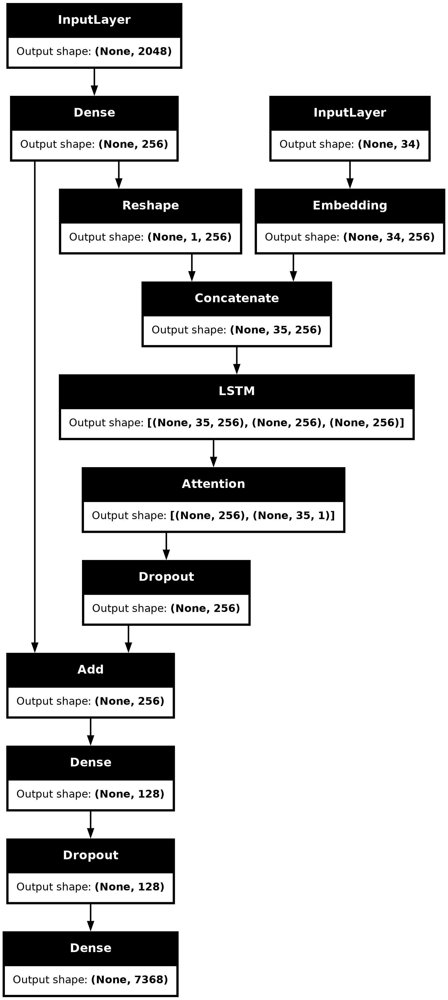

In [ ]:
model = build_model(256, max_len, vocab_size)
plot_model(model, show_shapes=True)

In [ ]:
model_name = "attention.keras"
checkpoint = ModelCheckpoint(model_name,
                            monitor="val_loss",
                            mode="min",
                            save_best_only = True,
                            verbose=1)

In [ ]:
 history = model.fit(
        train_generator,
        validation_data = validation_generator,
        callbacks=[checkpoint, earlystopping],
        epochs=50)

Epoch 1/50


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:120: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


468/468 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step - accuracy: 0.1154 - loss: 5.8511
Epoch 1: val_loss improved from inf to 4.50086, saving model to attention.keras
468/468 ━━━━━━━━━━━━━━━━━━━━ 64s 126ms/step - accuracy: 0.1155 - loss: 5.8499 - val_accuracy: 0.2054 - val_loss: 4.5009
Epoch 2/50
468/468 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step - accuracy: 0.2121 - loss: 4.5137
Epoch 2: val_loss improved from 4.50086 to 4.00417, saving model to attention.keras
468/468 ━━━━━━━━━━━━━━━━━━━━ 59s 124ms/step - accuracy: 0.2121 - loss: 4.5135 - val_accuracy: 0.2679 - val_loss: 4.0042
Epoch 3/50
468/468 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step - accuracy: 0.2570 - loss: 4.0717
Epoch 3: val_loss improved from 4.00417 to 3.80573, saving model to attention.keras
468/468 ━━━━━━━━━━━━━━━━━━━━ 58s 122ms/step - accuracy: 0.2570 - loss: 4.0716 - val_accuracy: 0.2837 - val_loss: 3.8057
Epoch 4/50
468/468 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step - accuracy: 0.2745 - loss: 3.8616
Epoch 4: val_loss improved from 3.80573 to 3.71526,

In [ ]:
print("start")
evaluate_model(model, test_data, tokenizer, max_len, features['test'])
print("finished")

start
BLEU-1: 0.343246
BLEU-2: 0.204782
BLEU-3: 0.134640
BLEU-4: 0.058412
finished


## References

- https://huggingface.co/datasets/jxie/flickr8k
- https://rupamgoyal12.medium.com/image-caption-generator-using-resnet50-and-lstm-model-a5b11f60cd23
- https://www.geeksforgeeks.org/residual-networks-resnet-deep-learning/
- https://stackoverflow.com/questions/47555829/preprocess-input-method-in-keras
- https://machinelearningmastery.com/calculate-bleu-score-for-text-python/
- https://luckytoilet.wordpress.com/2018/03/22/i-trained-a-neural-network-to-describe-pictures-and-its-hilariously-bad/
- https://www.kaggle.com/code/ramoliyafenil/image-captioning#Modelling

- https://www.analyticsvidhya.com/blog/2019/11/comprehensive-guide-attention-mechanism-deep-learning/
- https://towardsdatascience.com/foundations-of-nlp-explained-bleu-score-and-wer-metrics-1a5ba06d812b
